<a id = '0.0'></a>
<p style = "font-size : 35px; color : black ; text-align : center; background-color : yellow; border-radius: 5px 5px;"><strong>Market Basket Analysis and Recommendation Systems for Strategic Growth</strong></p>  

<img style="margin-left: 18%; float: center;  border:2px solid ; width:60%; height : 80%;" src="https://hoffmanmarcom.com/dev/wp-content/uploads/2015/05/dreamstime_s_45350418.jpg">


<font color="yellow" size=+2.5><b>Table of Contents</b></font>

<a href="#IL" class="btn btn-primary btn-sm" role="button" aria-pressed="true" 
style="color:white" data-toggle="popover"> <font color="lightseagreen" size=3><b>1- Importing Libraries</b></font></a>

<a href="#ID" class="btn btn-primary btn-sm" role="button" aria-pressed="true" 
style="color:white" data-toggle="popover"> <font color="lightseagreen" size=3><b>2- Importing Dataset</b></font></a>

<a href="#DE" class="btn btn-primary btn-sm" role="button" aria-pressed="true" 
style="color:white" data-toggle="popover"> <font color="lightseagreen" size=3><b>3- Basic Data Exploration(Understanding the Dataset)</b></font></a>

<a href="#DC" class="btn btn-primary btn-sm" role="button" aria-pressed="true" 
style="color:white" data-toggle="popover"> <font color="lightseagreen" size=3><b>4- Data Processing</b></font></a>

<a href="#EDA" class="btn btn-primary btn-sm" role="button" aria-pressed="true" 
style="color:white" data-toggle="popover"> <font color="lightseagreen" size=3><b>5- Sales Recommendation</b></font></a>

<a href="#EDA" class="btn btn-primary btn-sm" role="button" aria-pressed="true" 
style="color:white" data-toggle="popover"> <font color="lightseagreen" size=3><b>6- Data Analysis</b></font></a>

<a id = 'IL'></a>
<p class="list-group-item list-group-item-action" id = '0.1' data-toggle="list" href="#1" role="tab" aria-controls="profile" style="background-color:yellow;font-size : 30px;color:black">1- Importing Libraries

In [241]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import networkx as nx
plt.style.use('dark_background')
import warnings
warnings.filterwarnings('ignore')

from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules
from mlxtend.preprocessing import TransactionEncoder

<a id = 'ID'></a>
<p class="list-group-item list-group-item-action" id = '0.1' data-toggle="list" href="#1" role="tab" aria-controls="profile" style="background-color:yellow;font-size : 30px;color:black">2- Importing Dataset

In [243]:
data = pd.read_csv('Items_per_Transaction.csv')

<a id = 'DE'></a>
<p class="list-group-item list-group-item-action" id = '0.1' data-toggle="list" href="#1" role="tab" aria-controls="profile" style="background-color:yellow;font-size : 30px;color:black">3- Basic Data Exploration(Understanding the Dataset)

<font color="orange" size=3><b>We will check the below things:</b></font>

* `Head of the dataset`
* `The shape of the dataset`
* `Datatypes for every column`

In [246]:
data.head().style.background_gradient()

,InvoiceNo,Description
0,536370,"ALARM CLOCK BAKELIKE PINK,ALARM CLOCK BAKELIKE RED,ALARM CLOCK BAKELIKE GREEN,PANDA AND BUNNIES STICKER SHEET,STARS GIFT TAPE,INFLATABLE POLITICAL GLOBE,VINTAGE HEADS AND TAILS CARD GAME,SET/2 RED RETROSPOT TEA TOWELS,ROUND SNACK BOXES SET OF4 WOODLAND,SPACEBOY LUNCH BOX,LUNCH BOX I LOVE LONDON,CIRCUS PARADE LUNCH BOX,CHARLOTTE BAG DOLLY GIRL DESIGN,RED TOADSTOOL LED NIGHT LIGHT,SET 2 TEA TOWELS I LOVE LONDON,VINTAGE SEASIDE JIGSAW PUZZLES,MINI JIGSAW CIRCUS PARADE,MINI JIGSAW SPACEBOY,MINI PAINT SET VINTAGE"
1,536403,HAND WARMER BIRD DESIGN
2,536527,"SET OF 6 T-LIGHTS SANTA,ROTATING SILVER ANGELS T-LIGHT HLDR,MULTI COLOUR SILVER T-LIGHT HOLDER,5 HOOK HANGER MAGIC TOADSTOOL,3 HOOK HANGER MAGIC GARDEN,5 HOOK HANGER RED MAGIC TOADSTOOL,ASSORTED COLOUR LIZARD SUCTION HOOK,JUMBO BAG WOODLAND ANIMALS,JUMBO BAG OWLS,HOT WATER BOTTLE BABUSHKA,HOMEMADE JAM SCENTED CANDLES,CHILDREN'S CIRCUS PARADE MUG,PACK 3 FIRE ENGINE/CAR PATCHES,PICTURE DOMINOES"
3,536840,"JAM MAKING SET PRINTED,JAM JAR WITH PINK LID,JAM JAR WITH GREEN LID,SWEETHEART CAKESTAND 3 TIER,60 CAKE CASES VINTAGE CHRISTMAS,6 RIBBONS RUSTIC CHARM,CAKE STAND WHITE TWO TIER LACE,PACK OF 60 PINK PAISLEY CAKE CASES,60 TEATIME FAIRY CAKE CASES,PACK OF 72 RETROSPOT CAKE CASES"
4,536852,"PICTURE DOMINOES,MINI JIGSAW SPACEBOY,MINI JIGSAW DOLLY GIRL,CHARLOTTE BAG DOLLY GIRL DESIGN,VINTAGE HEADS AND TAILS CARD GAME,POLKADOT RAIN HAT"


In [247]:
print(f"The Shape Of Data is : {data.shape[0]} Rows and {data.shape[1]} Columns" )

The Shape Of Data is : 1108 Rows and 2 Columns


In [248]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1108 entries, 0 to 1107
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   InvoiceNo    1108 non-null   int64 
 1   Description  1108 non-null   object
dtypes: int64(1), object(1)
memory usage: 17.4+ KB


In [249]:
items_list = [item.split(",") for item in data["Description"]]
items_list

[['ALARM CLOCK BAKELIKE PINK',
  'ALARM CLOCK BAKELIKE RED',
  'ALARM CLOCK BAKELIKE GREEN',
  'PANDA AND BUNNIES STICKER SHEET',
  'STARS GIFT TAPE',
  'INFLATABLE POLITICAL GLOBE',
  'VINTAGE HEADS AND TAILS CARD GAME',
  'SET/2 RED RETROSPOT TEA TOWELS',
  'ROUND SNACK BOXES SET OF4 WOODLAND',
  'SPACEBOY LUNCH BOX',
  'LUNCH BOX I LOVE LONDON',
  'CIRCUS PARADE LUNCH BOX',
  'CHARLOTTE BAG DOLLY GIRL DESIGN',
  'RED TOADSTOOL LED NIGHT LIGHT',
  'SET 2 TEA TOWELS I LOVE LONDON',
  'VINTAGE SEASIDE JIGSAW PUZZLES',
  'MINI JIGSAW CIRCUS PARADE',
  'MINI JIGSAW SPACEBOY',
  'MINI PAINT SET VINTAGE'],
 ['HAND WARMER BIRD DESIGN'],
 ['SET OF 6 T-LIGHTS SANTA',
  'ROTATING SILVER ANGELS T-LIGHT HLDR',
  'MULTI COLOUR SILVER T-LIGHT HOLDER',
  '5 HOOK HANGER MAGIC TOADSTOOL',
  '3 HOOK HANGER MAGIC GARDEN',
  '5 HOOK HANGER RED MAGIC TOADSTOOL',
  'ASSORTED COLOUR LIZARD SUCTION HOOK',
  'JUMBO BAG WOODLAND ANIMALS',
  'JUMBO BAG OWLS',
  'HOT WATER BOTTLE BABUSHKA',
  'HOMEMADE JAM SCEN

<a id = 'DE'></a>
<p class="list-group-item list-group-item-action" id = '0.1' data-toggle="list" href="#1" role="tab" aria-controls="profile" style="background-color:yellow;font-size : 30px;color:black">4- Data Processing

* `Convert item lists into transaction data for frequent itemset mining`

In [252]:
te = TransactionEncoder()

te_array = te.fit(items_list).transform(items_list)

te_array

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [ True, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

* `Creating a Dataframe using the column in transactionencoder and the rows from transactionencoder array`

In [254]:
item_df = pd.DataFrame(te_array, columns = te.columns_)
item_df.head().style.background_gradient()

,,1 HANGER,BACK DOOR,BILLBOARD FONTS DESIGN,BIRTHDAY CARD,BREAKFAST IN BED,CHOCOLATE SPOTS,DOUGHNUTS,NEW ENGLAND,OVERCROWDED POOL.,PINK SPOTS,RETRO SPOT,SHED,STICKY GORDON,TWO SISTERS.,10 COLOUR SPACEBOY PEN,12 COLOURED PARTY BALLOONS,12 EGG HOUSE PAINTED WOOD,12 IVORY ROSE PEG PLACE SETTINGS,12 MESSAGE CARDS WITH ENVELOPES,12 PENCIL SMALL TUBE WOODLAND,12 PENCILS SMALL TUBE RED RETROSPOT,12 PENCILS SMALL TUBE SKULL,12 PENCILS TALL TUBE POSY,12 PENCILS TALL TUBE RED RETROSPOT,12 PENCILS TALL TUBE SKULLS,12 PENCILS TALL TUBE WOODLAND,12 PINK HEN+CHICKS IN BASKET,12 RED ROSE PEG PLACE SETTINGS,15CM CHRISTMAS GLASS BALL 20 LIGHTS,16 PIECE CUTLERY SET PANTRY DESIGN,18PC WOODEN CUTLERY SET DISPOSABLE,2 PICTURE BOOK EGGS EASTER BUNNY,2 PICTURE BOOK EGGS EASTER CHICKS,20 DOLLY PEGS RETROSPOT,200 BENDY SKULL STRAWS,200 RED + WHITE BENDY STRAWS,3 DRAWER ANTIQUE WHITE WOOD CABINET,3 HEARTS HANGING DECORATION RUSTIC,3 HOOK HANGER MAGIC GARDEN,3 HOOK PHOTO SHELF ANTIQUE WHITE,3 PIECE SPACEBOY COOKIE CUTTER SET,3 RAFFIA RIBBONS 50'S CHRISTMAS,3 RAFFIA RIBBONS VINTAGE CHRISTMAS,3 ROSE MORRIS BOXED CANDLES,3 STRIPEY MICE FELTCRAFT,3 TIER CAKE TIN GREEN AND CREAM,3 TIER CAKE TIN RED AND CREAM,3 TIER SWEETHEART GARDEN SHELF,3 TRADITIONAl BISCUIT CUTTERS SET,3 WHITE CHOC MORRIS BOXED CANDLES,36 DOILIES DOLLY GIRL,36 DOILIES VINTAGE CHRISTMAS,36 FOIL HEART CAKE CASES,36 FOIL STAR CAKE CASES,36 PENCILS TUBE RED RETROSPOT,36 PENCILS TUBE SKULLS,36 PENCILS TUBE WOODLAND,3D CHRISTMAS STAMPS STICKERS,3D DOG PICTURE PLAYING CARDS,3D HEARTS HONEYCOMB PAPER GARLAND,3D SHEET OF DOG STICKERS,3D TRADITIONAL CHRISTMAS STICKERS,3D VINTAGE CHRISTMAS STICKERS,4 IVORY DINNER CANDLES SILVER FLOCK,4 LAVENDER BOTANICAL DINNER CANDLES,4 PINK DINNER CANDLE SILVER FLOCK,4 TRADITIONAL SPINNING TOPS,5 HOOK HANGER MAGIC TOADSTOOL,5 HOOK HANGER RED MAGIC TOADSTOOL,50'S CHRISTMAS GIFT BAG LARGE,50'S CHRISTMAS PAPER GIFT BAG,6 EGG HOUSE PAINTED WOOD,6 GIFT TAGS 50'S CHRISTMAS,6 GIFT TAGS VINTAGE CHRISTMAS,6 RIBBONS ELEGANT CHRISTMAS,6 RIBBONS EMPIRE,6 RIBBONS RUSTIC CHARM,6 RIBBONS SHIMMERING PINKS,6 ROCKET BALLOONS,60 CAKE CASES DOLLY GIRL DESIGN,60 CAKE CASES VINTAGE CHRISTMAS,60 TEATIME FAIRY CAKE CASES,6PC WOOD PLATE SET DISPOSABLE,72 SWEETHEART FAIRY CAKE CASES,A PRETTY THANK YOU CARD,ABC TREASURE BOOK BOX,ABSTRACT CIRCLE JOURNAL,ABSTRACT CIRCLES SKETCHBOOK,ACRYLIC GEOMETRIC LAMP,ACRYLIC HANGING JEWEL,ADULT APRON APPLE DELIGHT,ADVENT CALENDAR GINGHAM SACK,AGED GLASS SILVER T-LIGHT HOLDER,AIRLINE BAG VINTAGE JET SET BROWN,AIRLINE BAG VINTAGE JET SET RED,AIRLINE BAG VINTAGE JET SET WHITE,AIRLINE BAG VINTAGE TOKYO 78,AIRLINE BAG VINTAGE WORLD CHAMPION,AIRLINE LOUNGE,ALARM CLOCK BAKELIKE CHOCOLATE,ALARM CLOCK BAKELIKE GREEN,ALARM CLOCK BAKELIKE IVORY,ALARM CLOCK BAKELIKE ORANGE,ALARM CLOCK BAKELIKE PINK,ALARM CLOCK BAKELIKE RED,ALPHABET HEARTS STICKER SHEET,ALPHABET STENCIL CRAFT,ALUMINIUM STAMPED HEART,AMETHYST CHUNKY BEAD BRACELET W STR,ANGEL DECORATION PAINTED ZINC,ANGEL DECORATION STARS ON DRESS,ANIMAL STICKERS,ANT COPPER LIME BOUDICCA BRACELET,ANT COPPER PINK BOUDICCA BRACELET,ANT COPPER TURQ BOUDICCA BRACELET,ANTIQUE ALL GLASS CANDLESTICK,ANTIQUE GLASS DRESSING TABLE POT,ANTIQUE GLASS PEDESTAL BOWL,ANTIQUE GLASS PLACE SETTING,ANTIQUE HEART SHELF UNIT,ANTIQUE MID BLUE FLOWER EARRINGS,ANTIQUE OLIVE GREEN FLOWER EARRINGS,ANTIQUE SILVER BAUBLE LAMP,ANTIQUE SILVER T-LIGHT GLASS,ANTIQUE SILVER TEA GLASS ENGRAVED,ANTIQUE SILVER TEA GLASS ETCHED,ANTIQUE TALL SWIRLGLASS TRINKET POT,APOTHECARY MEASURING JAR,APPLE BATH SPONGE,APRON APPLE DELIGHT,AREA PATROLLED METAL SIGN,ASS COLOUR GLOWING TIARAS,ASS FLORAL PRINT MULTI SCREWDRIVER,ASSORTED BOTTLE TOP MAGNETS,ASSORTED COLOUR BIRD ORNAMENT,ASSORTED COLOUR LIZARD SUCTION HOOK,ASSORTED COLOUR MINI CASES,ASSORTED COLOUR T-LIGHT HOLDER,ASSORTED COLOURS SILK FAN,ASSORTED EASTER DECORATIONS BELLS,ASSORTED EASTER GIFT TAGS,"ASSORTED FLOWER COLOUR ""LEIS""",ASSORTED MONKEY SUCTION CUP HOOK,ASSORTED TUTTI FRUTTI FOB NOTEBOOK,ASSORTED TUT

* `Removing the blank column`

In [256]:
item_df[""].value_counts()
item_df = item_df.drop("", axis = 1)
item_df.shape

(1108, 2362)

<a id = 'DE'></a>
<p class="list-group-item list-group-item-action" id = '0.1' data-toggle="list" href="#1" role="tab" aria-controls="profile" style="background-color:yellow;font-size : 30px;color:black">5- Sales Recommendation

In [258]:
spaceboy_box_df = item_df[item_df["SPACEBOY LUNCH BOX"] == True]

spaceboy_box_df[["SPACEBOY LUNCH BOX"]].style.background_gradient()

,SPACEBOY LUNCH BOX
0,True
14,True
48,True
57,True
71,True
72,True
74,True
77,True
81,True
86,True


In [259]:
dolly_box_df = item_df[item_df["DOLLY GIRL LUNCH BOX"] == True]

dolly_box_df[["DOLLY GIRL LUNCH BOX"]].style.background_gradient()

,DOLLY GIRL LUNCH BOX
27,True
48,True
74,True
86,True
95,True
97,True
105,True
107,True
108,True
119,True


In [260]:
spaceboy_dolly = item_df[(item_df["SPACEBOY LUNCH BOX"] == True) & 
                         (item_df["DOLLY GIRL LUNCH BOX"] == True)]

spaceboy_dolly[["SPACEBOY LUNCH BOX", "DOLLY GIRL LUNCH BOX"]].style.background_gradient()

,SPACEBOY LUNCH BOX,DOLLY GIRL LUNCH BOX
48,True,True
74,True,True
86,True,True
95,True,True
105,True,True
107,True,True
119,True,True
122,True,True
131,True,True
149,True,True


In [261]:
pd.set_option('display.max_colwidth', None)

* `Apriori Algorithm`

In [263]:
frequant_items = apriori(item_df , min_support=0.01 , use_colnames=True)
frequant_items.sort_values("support" , ascending=False).style.background_gradient()

,support,itemsets
392,0.221119,frozenset({'ROUND SNACK BOXES SET OF4 WOODLAND'})
309,0.142599,frozenset({'PLASTERS IN TIN WOODLAND ANIMALS'})
363,0.142599,frozenset({'REGENCY CAKESTAND 3 TIER'})
390,0.140794,frozenset({'ROUND SNACK BOXES SET OF 4 FRUITS'})
481,0.137184,frozenset({'SPACEBOY LUNCH BOX'})
304,0.129964,frozenset({'PLASTERS IN TIN CIRCUS PARADE'})
361,0.124549,frozenset({'RED TOADSTOOL LED NIGHT LIGHT'})
306,0.115523,frozenset({'PLASTERS IN TIN SPACEBOY'})
1955,0.106498,"frozenset({'ROUND SNACK BOXES SET OF 4 FRUITS', 'ROUND SNACK BOXES SET OF4 WOODLAND'})"
538,0.104693,frozenset({'WOODLAND CHARLOTTE BAG'})


In [264]:
frequent_items = apriori(item_df, min_support = 0.02, use_colnames = True)

frequent_items.sort_values("support", ascending = False).style.background_gradient()

,support,itemsets
195,0.221119,frozenset({'ROUND SNACK BOXES SET OF4 WOODLAND'})
181,0.142599,frozenset({'REGENCY CAKESTAND 3 TIER'})
152,0.142599,frozenset({'PLASTERS IN TIN WOODLAND ANIMALS'})
194,0.140794,frozenset({'ROUND SNACK BOXES SET OF 4 FRUITS'})
245,0.137184,frozenset({'SPACEBOY LUNCH BOX'})
147,0.129964,frozenset({'PLASTERS IN TIN CIRCUS PARADE'})
179,0.124549,frozenset({'RED TOADSTOOL LED NIGHT LIGHT'})
149,0.115523,frozenset({'PLASTERS IN TIN SPACEBOY'})
522,0.106498,"frozenset({'ROUND SNACK BOXES SET OF 4 FRUITS', 'ROUND SNACK BOXES SET OF4 WOODLAND'})"
265,0.104693,frozenset({'WOODLAND CHARLOTTE BAG'})


* `Association_Rules`

In [266]:
assoc_rules = association_rules(frequent_items, metric = "support", min_threshold = 0.10)

assoc_rules.style.background_gradient()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,frozenset({'ROUND SNACK BOXES SET OF 4 FRUITS'}),frozenset({'ROUND SNACK BOXES SET OF4 WOODLAND'}),0.140794,0.221119,0.106498,0.756410,3.420827,1.000000,0.075366,3.197511,0.823636,0.416961,0.687257,0.619021
1,frozenset({'ROUND SNACK BOXES SET OF4 WOODLAND'}),frozenset({'ROUND SNACK BOXES SET OF 4 FRUITS'}),0.221119,0.140794,0.106498,0.481633,3.420827,1.000000,0.075366,1.657523,0.908577,0.416961,0.396690,0.619021


In [267]:
assoc_rules = association_rules(frequent_items, metric = "support", min_threshold = 0.05)

assoc_rules.sample(5).style.background_gradient()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
6,frozenset({'PLASTERS IN TIN SPACEBOY'}),frozenset({'PLASTERS IN TIN CIRCUS PARADE'}),0.115523,0.129964,0.062274,0.539062,4.147786,1.000000,0.047260,1.887536,0.858030,0.339901,0.470209,0.509115
21,frozenset({'ROUND SNACK BOXES SET OF4 WOODLAND'}),frozenset({'ROUND SNACK BOXES SET OF 4 FRUITS'}),0.221119,0.140794,0.106498,0.481633,3.420827,1.000000,0.075366,1.657523,0.908577,0.416961,0.396690,0.619021
14,frozenset({'ROUND SNACK BOXES SET OF4 WOODLAND'}),frozenset({'PLASTERS IN TIN SPACEBOY'}),0.221119,0.115523,0.051444,0.232653,2.013903,1.000000,0.025900,1.152642,0.646378,0.180380,0.132428,0.338983
26,frozenset({'SET/20 RED RETROSPOT PAPER NAPKINS'}),frozenset({'SET/6 RED SPOTTY PAPER PLATES'}),0.091155,0.078520,0.055054,0.603960,7.691817,1.000000,0.047897,2.326737,0.957250,0.480315,0.570214,0.652555
34,frozenset({'SET/20 RED RETROSPOT PAPER NAPKINS'}),"frozenset({'SET/6 RED SPOTTY PAPER CUPS', 'SET/6 RED SPOTTY PAPER PLATES'})",0.091155,0.070397,0.050542,0.554455,7.876111,1.000000,0.044124,2.086442,0.960597,0.455285,0.520715,0.636202


In [268]:
assoc_rules.sort_values("support", ascending = False).head(5).style.background_gradient()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
20,frozenset({'ROUND SNACK BOXES SET OF 4 FRUITS'}),frozenset({'ROUND SNACK BOXES SET OF4 WOODLAND'}),0.140794,0.221119,0.106498,0.756410,3.420827,1.000000,0.075366,3.197511,0.823636,0.416961,0.687257,0.619021
21,frozenset({'ROUND SNACK BOXES SET OF4 WOODLAND'}),frozenset({'ROUND SNACK BOXES SET OF 4 FRUITS'}),0.221119,0.140794,0.106498,0.481633,3.420827,1.000000,0.075366,1.657523,0.908577,0.416961,0.396690,0.619021
8,frozenset({'PLASTERS IN TIN WOODLAND ANIMALS'}),frozenset({'PLASTERS IN TIN CIRCUS PARADE'}),0.142599,0.129964,0.076715,0.537975,4.139416,1.000000,0.058182,1.883092,0.884557,0.391705,0.468958,0.564126
9,frozenset({'PLASTERS IN TIN CIRCUS PARADE'}),frozenset({'PLASTERS IN TIN WOODLAND ANIMALS'}),0.129964,0.142599,0.076715,0.590278,4.139416,1.000000,0.058182,2.092639,0.871711,0.391705,0.522135,0.564126
12,frozenset({'PLASTERS IN TIN SPACEBOY'}),frozenset({'PLASTERS IN TIN WOODLAND ANIMALS'}),0.115523,0.142599,0.075812,0.656250,4.602057,1.000000,0.059339,2.494257,0.884937,0.415842,0.599079,0.593948


In [269]:
assoc_rules = association_rules(frequent_items, metric = "support", min_threshold = 0.02)

assoc_rules.shape

(976, 14)

In [270]:
assoc_rules[(assoc_rules["confidence"] >= 0.9) & (assoc_rules["lift"] >= 25)] \
    .sort_values("confidence", ascending = False).style.background_gradient()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
596,"frozenset({'SPACEBOY CHILDRENS BOWL', 'DOLLY GIRL CHILDRENS CUP'})",frozenset({'DOLLY GIRL CHILDRENS BOWL'}),0.027978,0.037906,0.027978,1.000000,26.380952,1.000000,0.026918,inf,0.989786,0.738095,1.000000,0.869048
603,"frozenset({'SPACEBOY CHILDRENS CUP', 'DOLLY GIRL CHILDRENS BOWL'})",frozenset({'DOLLY GIRL CHILDRENS CUP'}),0.025271,0.035199,0.025271,1.000000,28.410256,1.000000,0.024381,inf,0.989815,0.717949,1.000000,0.858974
920,"frozenset({'SPACEBOY CHILDRENS CUP', 'SPACEBOY CHILDRENS BOWL', 'DOLLY GIRL CHILDRENS CUP'})",frozenset({'DOLLY GIRL CHILDRENS BOWL'}),0.024368,0.037906,0.024368,1.000000,26.380952,1.000000,0.023445,inf,0.986124,0.642857,1.000000,0.821429
921,"frozenset({'SPACEBOY CHILDRENS CUP', 'SPACEBOY CHILDRENS BOWL', 'DOLLY GIRL CHILDRENS BOWL'})",frozenset({'DOLLY GIRL CHILDRENS CUP'}),0.024368,0.035199,0.024368,1.000000,28.410256,1.000000,0.023511,inf,0.988899,0.692308,1.000000,0.846154
926,"frozenset({'SPACEBOY CHILDRENS CUP', 'DOLLY GIRL CHILDRENS BOWL'})","frozenset({'SPACEBOY CHILDRENS BOWL', 'DOLLY GIRL CHILDRENS CUP'})",0.025271,0.027978,0.024368,0.964286,34.465438,1.000000,0.023661,27.216606,0.996159,0.843750,0.963258,0.917627
723,"frozenset({'PACK OF 20 SKULL PAPER NAPKINS', 'SET/6 RED SPOTTY PAPER PLATES'})",frozenset({'PACK OF 6 SKULL PAPER PLATES'}),0.022563,0.036101,0.021661,0.960000,26.592000,1.000000,0.020846,24.097473,0.984611,0.585366,0.958502,0.780000
880,"frozenset({""POPPY'S PLAYHOUSE BEDROOM"", ""POPPY'S PLAYHOUSE LIVINGROOM""})","frozenset({""POPPY'S PLAYHOUSE KITCHEN""})",0.021661,0.037906,0.020758,0.958333,25.281746,1.000000,0.019937,23.090253,0.981710,0.534884,0.956692,0.752976
879,"frozenset({""POPPY'S PLAYHOUSE KITCHEN"", ""POPPY'S PLAYHOUSE LIVINGROOM""})","frozenset({""POPPY'S PLAYHOUSE BEDROOM""})",0.022563,0.035199,0.020758,0.920000,26.137436,1.000000,0.019964,12.060018,0.983942,0.560976,0.917081,0.754872


* `Visualizing where the items for support and confidence we can see that there are some items which are having low support and confidence and there are some items the are having low support but confidence and there are some items having high support and confidence and is categorizing according to lift `
  
* `Also high lift have a relatively low support`

Text(0, 0.5, 'Confidence')

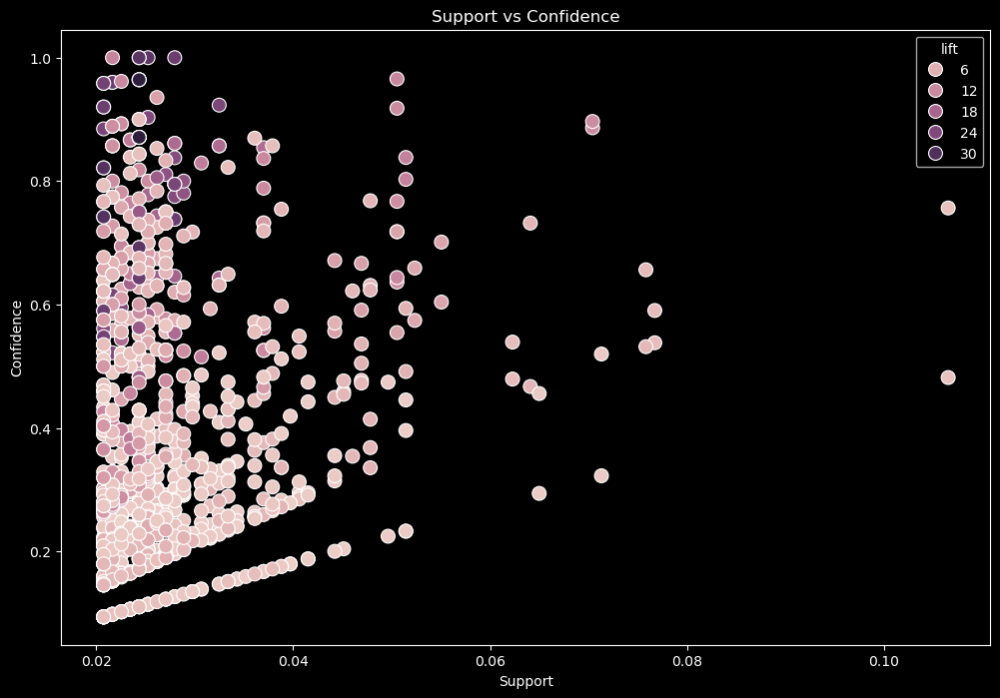

In [272]:
plt.figure(figsize = (12, 8))

sns.scatterplot(x = "support", 
                y = "confidence", data = assoc_rules , 
                hue = "lift", s = 100)
        
plt.title("Support vs Confidence")

plt.xlabel("Support")
plt.ylabel("Confidence")

* `Showing we can filter on the specific itemset and the itemset is itself frozenset as shown above`

In [274]:
assoc_rules[assoc_rules["antecedents"] == {"SPACEBOY CHILDRENS BOWL"}].style.background_gradient()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
112,frozenset({'SPACEBOY CHILDRENS BOWL'}),frozenset({'DOLLY GIRL CHILDRENS BOWL'}),0.050542,0.037906,0.032491,0.642857,16.959184,1.000000,0.030575,2.693863,0.991128,0.580645,0.628786,0.750000
116,frozenset({'SPACEBOY CHILDRENS BOWL'}),frozenset({'DOLLY GIRL CHILDRENS CUP'}),0.050542,0.035199,0.027978,0.553571,15.727106,1.000000,0.026199,2.161155,0.986263,0.484375,0.537285,0.674222
523,frozenset({'SPACEBOY CHILDRENS BOWL'}),frozenset({'ROUND SNACK BOXES SET OF4 WOODLAND'}),0.050542,0.221119,0.028881,0.571429,2.584257,1.000000,0.017705,1.817389,0.645675,0.118959,0.449760,0.351020
555,frozenset({'SPACEBOY CHILDRENS BOWL'}),frozenset({'SPACEBOY CHILDRENS CUP'}),0.050542,0.043321,0.037004,0.732143,16.900298,1.000000,0.034814,3.571600,0.990912,0.650794,0.720013,0.793155
599,frozenset({'SPACEBOY CHILDRENS BOWL'}),"frozenset({'DOLLY GIRL CHILDRENS CUP', 'DOLLY GIRL CHILDRENS BOWL'})",0.050542,0.032491,0.027978,0.553571,17.037698,1.000000,0.026336,2.167220,0.991414,0.508197,0.538579,0.707341
612,frozenset({'SPACEBOY CHILDRENS BOWL'}),"frozenset({'SPACEBOY CHILDRENS CUP', 'DOLLY GIRL CHILDRENS BOWL'})",0.050542,0.025271,0.024368,0.482143,19.079082,1.000000,0.023091,1.882236,0.998028,0.473684,0.468717,0.723214
618,frozenset({'SPACEBOY CHILDRENS BOWL'}),"frozenset({'SPACEBOY CHILDRENS CUP', 'DOLLY GIRL CHILDRENS CUP'})",0.050542,0.027978,0.024368,0.482143,17.232719,1.000000,0.022954,1.877007,0.992114,0.450000,0.467237,0.676555
931,frozenset({'SPACEBOY CHILDRENS BOWL'}),"frozenset({'SPACEBOY CHILDRENS CUP', 'DOLLY GIRL CHILDRENS CUP', 'DOLLY GIRL CHILDRENS BOWL'})",0.050542,0.025271,0.024368,0.482143,19.079082,1.000000,0.023091,1.882236,0.998028,0.473684,0.468717,0.723214


In [275]:
assoc_rules[assoc_rules["antecedents"] == {"DOLLY GIRL CHILDRENS CUP", "SPACEBOY CHILDRENS CUP"}].style.background_gradient()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
602,"frozenset({'SPACEBOY CHILDRENS CUP', 'DOLLY GIRL CHILDRENS CUP'})",frozenset({'DOLLY GIRL CHILDRENS BOWL'}),0.027978,0.037906,0.025271,0.903226,23.827957,1.000000,0.024210,9.941637,0.985608,0.622222,0.899413,0.784946
615,"frozenset({'SPACEBOY CHILDRENS CUP', 'DOLLY GIRL CHILDRENS CUP'})",frozenset({'SPACEBOY CHILDRENS BOWL'}),0.027978,0.050542,0.024368,0.870968,17.232719,1.000000,0.022954,7.358303,0.969084,0.450000,0.864099,0.676555
925,"frozenset({'SPACEBOY CHILDRENS CUP', 'DOLLY GIRL CHILDRENS CUP'})","frozenset({'SPACEBOY CHILDRENS BOWL', 'DOLLY GIRL CHILDRENS BOWL'})",0.027978,0.032491,0.024368,0.870968,26.806452,1.000000,0.023459,7.498195,0.990405,0.675000,0.866635,0.810484


In [276]:
assoc_rules[assoc_rules["consequents"] == {"ALARM CLOCK BAKELIKE RED"}].style.background_gradient()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
3,frozenset({'ALARM CLOCK BAKELIKE CHOCOLATE'}),frozenset({'ALARM CLOCK BAKELIKE RED'}),0.027076,0.070397,0.021661,0.800000,11.364103,1.000000,0.019755,4.648014,0.937384,0.285714,0.784854,0.553846
7,frozenset({'ALARM CLOCK BAKELIKE GREEN'}),frozenset({'ALARM CLOCK BAKELIKE RED'}),0.065884,0.070397,0.050542,0.767123,10.897085,1.000000,0.045903,3.991824,0.972291,0.589474,0.749488,0.742536
13,frozenset({'ALARM CLOCK BAKELIKE ORANGE'}),frozenset({'ALARM CLOCK BAKELIKE RED'}),0.028881,0.070397,0.022563,0.781250,11.097756,1.000000,0.020530,4.249613,0.936952,0.294118,0.764684,0.550881
15,frozenset({'ALARM CLOCK BAKELIKE PINK'}),frozenset({'ALARM CLOCK BAKELIKE RED'}),0.079422,0.070397,0.046931,0.590909,8.393939,1.000000,0.041340,2.272363,0.956863,0.456140,0.559929,0.628788
27,frozenset({'PLASTERS IN TIN SPACEBOY'}),frozenset({'ALARM CLOCK BAKELIKE RED'}),0.115523,0.070397,0.020758,0.179688,2.552484,1.000000,0.012626,1.133230,0.687666,0.125683,0.117567,0.237280
29,frozenset({'ROUND SNACK BOXES SET OF4 WOODLAND'}),frozenset({'ALARM CLOCK BAKELIKE RED'}),0.221119,0.070397,0.037004,0.167347,2.377185,1.000000,0.021437,1.116435,0.743804,0.145390,0.104292,0.346494
31,frozenset({'SPACEBOY LUNCH BOX'}),frozenset({'ALARM CLOCK BAKELIKE RED'}),0.137184,0.070397,0.025271,0.184211,2.616734,1.000000,0.015613,1.139513,0.716079,0.138614,0.122432,0.271592
568,"frozenset({'ALARM CLOCK BAKELIKE PINK', 'ALARM CLOCK BAKELIKE GREEN'})",frozenset({'ALARM CLOCK BAKELIKE RED'}),0.044224,0.070397,0.037004,0.836735,11.885924,1.000000,0.033890,5.693818,0.958244,0.476744,0.824371,0.681188
580,"frozenset({'ROUND SNACK BOXES SET OF4 WOODLAND', 'ALARM CLOCK BAKELIKE GREEN'})",frozenset({'ALARM CLOCK BAKELIKE RED'}),0.029783,0.070397,0.024368,0.818182,11.622378,1.000000,0.022272,5.112816,0.942016,0.321429,0.804413,0.582168
586,"frozenset({'ROUND SNACK BOXES SET OF4 WOODLAND', 'ALARM CLOCK BAKELIKE PINK'})",frozenset({'ALARM CLOCK BAKELIKE RED'}),0.032491,0.070397,0.024368,0.750000,10.653846,1.000000,0.022081,3.718412,0.936567,0.310345,0.731068,0.548077


In [277]:
assoc_rules[assoc_rules["consequents"] == {"DOLLY GIRL CHILDRENS CUP", "DOLLY GIRL CHILDRENS BOWL"}].style.background_gradient()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
599,frozenset({'SPACEBOY CHILDRENS BOWL'}),"frozenset({'DOLLY GIRL CHILDRENS CUP', 'DOLLY GIRL CHILDRENS BOWL'})",0.050542,0.032491,0.027978,0.553571,17.037698,1.000000,0.026336,2.167220,0.991414,0.508197,0.538579,0.707341
605,frozenset({'SPACEBOY CHILDRENS CUP'}),"frozenset({'DOLLY GIRL CHILDRENS CUP', 'DOLLY GIRL CHILDRENS BOWL'})",0.043321,0.032491,0.025271,0.583333,17.953704,1.000000,0.023863,2.322022,0.987062,0.500000,0.569341,0.680556
924,"frozenset({'SPACEBOY CHILDRENS CUP', 'SPACEBOY CHILDRENS BOWL'})","frozenset({'DOLLY GIRL CHILDRENS CUP', 'DOLLY GIRL CHILDRENS BOWL'})",0.037004,0.032491,0.024368,0.658537,20.268293,1.000000,0.023166,2.833419,0.987192,0.540000,0.647070,0.704268


<font color="yellow" size=+2.5><b>Recommending Consequents for a Antecedents</b></font>

In [279]:
frequent_items = apriori(item_df, min_support = 0.01, use_colnames = True)

frequent_items.style.background_gradient()

,support,itemsets
0,0.013538,frozenset({' BIRTHDAY CARD'})
1,0.010830,frozenset({' RETRO SPOT'})
2,0.026173,frozenset({'10 COLOUR SPACEBOY PEN'})
3,0.016245,frozenset({'12 PENCIL SMALL TUBE WOODLAND'})
4,0.013538,frozenset({'12 PENCILS SMALL TUBE RED RETROSPOT'})
5,0.010830,frozenset({'12 PENCILS SMALL TUBE SKULL'})
6,0.013538,frozenset({'12 PENCILS TALL TUBE RED RETROSPOT'})
7,0.016245,frozenset({'12 PENCILS TALL TUBE WOODLAND'})
8,0.012635,frozenset({'20 DOLLY PEGS RETROSPOT'})
9,0.021661,frozenset({'3 HOOK HANGER MAGIC GARDEN'})


In [280]:
assoc_rules = association_rules(frequent_items, metric = "support", min_threshold = 0.01)

assoc_rules.sort_values("support", ascending = False).style.background_gradient()

* `We know that ROUND SNACK BOXES SET OF4 WOODLAND is the most popular of the all items so we will see in antecedents column how many times ROUND SNACK BOXES SET OF4 WOODLAND is present.`

In [282]:
round_snack_boxes_antecedent = assoc_rules[assoc_rules["antecedents"] == {"ROUND SNACK BOXES SET OF4 WOODLAND"}]

round_snack_boxes_antecedent = round_snack_boxes_antecedent.sort_values("support", ascending = False).head(5)

round_snack_boxes_antecedent.style.background_gradient()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
2811,frozenset({'ROUND SNACK BOXES SET OF4 WOODLAND'}),frozenset({'ROUND SNACK BOXES SET OF 4 FRUITS'}),0.221119,0.140794,0.106498,0.481633,3.420827,1.000000,0.075366,1.657523,0.908577,0.416961,0.396690,0.619021
2879,frozenset({'ROUND SNACK BOXES SET OF4 WOODLAND'}),frozenset({'SPACEBOY LUNCH BOX'}),0.221119,0.137184,0.071300,0.322449,2.350483,1.000000,0.040966,1.273433,0.737668,0.248428,0.214721,0.421093
2428,frozenset({'ROUND SNACK BOXES SET OF4 WOODLAND'}),frozenset({'PLASTERS IN TIN WOODLAND ANIMALS'}),0.221119,0.142599,0.064982,0.293878,2.060863,1.000000,0.033451,1.214238,0.660905,0.217523,0.176438,0.374787
2254,frozenset({'ROUND SNACK BOXES SET OF4 WOODLAND'}),frozenset({'PLASTERS IN TIN CIRCUS PARADE'}),0.221119,0.129964,0.051444,0.232653,1.790136,1.000000,0.022707,1.133824,0.566689,0.171687,0.118029,0.314243
2338,frozenset({'ROUND SNACK BOXES SET OF4 WOODLAND'}),frozenset({'PLASTERS IN TIN SPACEBOY'}),0.221119,0.115523,0.051444,0.232653,2.013903,1.000000,0.025900,1.152642,0.646378,0.180380,0.132428,0.338983


Plotting the graph of the 5 most popular items that are recomended with ROUND SNACK BOXES SET OF4 WOODLAND

Text(0, 0.5, 'Recommended Items')

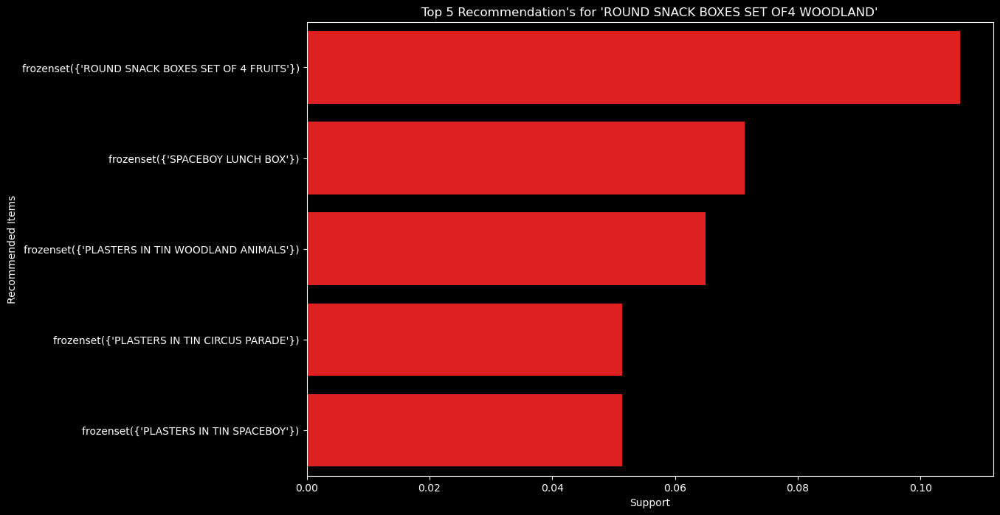

In [284]:
plt.figure(figsize = [12, 8])

x = sns.barplot(x = "support", y = "consequents", data = round_snack_boxes_antecedent, color = "red")

plt.title("Top 5 Recommendation's for 'ROUND SNACK BOXES SET OF4 WOODLAND'")
plt.xlabel("Support")
plt.ylabel("Recommended Items")